In [1]:
# basic libraries
import math
import os
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from sklearn.metrics import cohen_kappa_score

# torch libraries
import torch
from torch.utils.data import DataLoader
from torchvision import transforms, models, datasets
from torch import nn
from torch_snippets import Report
from torchsummary import summary
import torch.optim as optim




[07/01/23 20:29:04] WARNING  Unable to load torch and dependent libraries from                ]8;id=902493;file:///home/c97818a/mo434_venv/lib/python3.8/site-packages/torch_snippets/loader.py\loader.py]8;;\:]8;id=302552;file:///home/c97818a/mo434_venv/lib/python3.8/site-packages/torch_snippets/loader.py#<module>:98\<module>:98]8;;\
                             torch-snippets.                                                                       
                             Functionalities might be limited. pip install lovely-tensors in                       
                             case there are torch related errors                                                   

# Renaming images

In [2]:
root_path = "images_mo434/"

fish_types = {
              'Black Sea Sprat': '000',
              'Gilt-Head Bream': '001', #x.JPG
              'Hourse Mackerel': '002',
              'Red Mullet': '003',
              'Red Sea Bream': '004', #100-146x.JPG
              'Sea Bass': '005', #x.JPG
              'Shrimp': '006',
              'Striped Red Mullet': '007',
              'Trout': '008'
              }

In [3]:
# renaming images - do it only once, that's why is commented


# for f_type in fish_types:
#   for i,file_name in enumerate(os.listdir(root_path+f_type)):
#     os.rename(os.path.join(root_path, f_type, file_name), f'images_mo434/old_fish/{fish_types[f_type]}_{str(i)}.png')

# Preparing dataset

In [4]:
fish_path ="old_fish/"
img_paths = [fish_path+x for x in os.listdir(fish_path)]

In [7]:
# originally images have 1024x768
xsize = 512 # pixels
ysize = 384
nchannels = 3
maxval = 255 # pixel value

# percentages of samples to split
train_perc = 0.6
valid_perc = 0.3
test_perc = 0.1

In [8]:
num_train_samples = int(len(img_paths)*train_perc)
num_valid_samples = int(len(img_paths)*valid_perc)
num_test_samples = int(len(img_paths)*test_perc)

np.random.shuffle(img_paths)

train_set = img_paths[:num_train_samples]
valid_set = img_paths[num_train_samples:num_train_samples+num_valid_samples]
test_set = img_paths[num_train_samples+num_valid_samples:]

print(f"Train size: {len(train_set)}\nValid size: {len(valid_set)}\nTest size: {len(test_set)}")

Train size: 258
Valid size: 129
Test size: 43


In [9]:
# Augmenting the dataset virtually - the augmentation will make sure the images are different
# import random
# train_set = random.choices(train_set,k=500)
# print(f"Train size: {len(train_set)}\nValid size: {len(valid_set)}\nTest size: {len(test_set)}")

In [10]:
# rgb_values = np.concatenate(
#     [Image.open(img).getdata() for img in img_paths], 
#     axis=0
# ) / 255.

# mean_val_pixel = np.mean(rgb_values, axis=0)  # mu_rgb.shape == (3,)
# std_val_pixel = np.std(rgb_values, axis=0)  # std_rgb.shape == (3,)

#calculate this takes too long, so I wrote the result here:
mean_val_pixels = (0.420,0.424,0.460)
std_val_pixels = (0.230, 0.174 ,0.160)


print(f"Mean value of pixels: {mean_val_pixels}\nStandard deviation of pixels values: {std_val_pixels}")

Mean value of pixels: (0.42, 0.424, 0.46)
Standard deviation of pixels values: (0.23, 0.174, 0.16)


In [11]:
# Defining preprocessing transforms
prep = transforms.Compose([
    transforms.Resize((xsize, ysize), interpolation=transforms.InterpolationMode.BILINEAR,
                      max_size=None, antialias=True),
    transforms.ToTensor(),
    transforms.Normalize(mean_val_pixels, std_val_pixels) # mean, std
])

# Defining data augmentation to be implemented during training
aug  = transforms.Compose([
    transforms.Resize((600,400), interpolation=transforms.InterpolationMode.BILINEAR, 
                      max_size=None, antialias=True),
    transforms.RandomAffine(degrees=10, translate=(0.05,0.10), scale=(0.9,1.1), shear=(-2,2),
                            interpolation=transforms.InterpolationMode.BILINEAR, 
                            fill=0),
    transforms.CenterCrop(500),
    transforms.Resize((xsize,ysize), interpolation=transforms.InterpolationMode.BILINEAR, 
                      max_size=None, antialias=True),
    transforms.ToTensor(),
    transforms.Normalize(mean_val_pixels, std_val_pixels)
])

In [12]:
class ImageDataSet():

    def __init__(self, dataset, transform=None):
        self.dataset = dataset # list of image paths
        self.targets = [int(str(x).split("/")[-1].split("_")[0]) for x in self.dataset]
        self.transform = transform

    def __len__(self): 
        return len(self.dataset)

    def __getitem__(self, ix): #ix is the position
        filename = self.dataset[ix]
        target = self.targets[ix]
        image = Image.open(filename)
        if self.transform is not None:
            image = self.transform(image)
        else:
            image = torch.from_numpy(np.array(image)).permute(2,0,1).float()
        return(image, target)


In [13]:
def GetBatches(dataset, batchsize, transformation):
    datatensor = ImageDataSet(dataset, transformation)
    dataloader = DataLoader(datatensor, batch_size=batchsize, shuffle=True)
    return dataloader

In [14]:
batchsize = 30

trainload = GetBatches(train_set, batchsize, aug)  
validload = GetBatches(valid_set, batchsize, prep)
testload  = GetBatches(test_set, batchsize, prep) 

# CNN

In [15]:
# convolutional block
def conv_block(nchannels_in, nchannels_out, stride_val):
    return nn.Sequential(
        nn.Conv2d(in_channels=nchannels_in, out_channels=nchannels_out, 
                  kernel_size=(3,3), stride=1, padding=1, bias=False), 
        # stride é o passo que o kernel anda
        nn.BatchNorm2d(num_features=nchannels_out),
        nn.ReLU(),
        nn.MaxPool2d(kernel_size=(3,3), stride=stride_val, padding=1)
  )

In [16]:
class FishClassification(nn.Module):

    def _initialize_weights(self): #Xavier Initialization
        for m in self.modules():
            if isinstance(m, nn.Conv2d):
                #number of elements in the layer
                n = m.kernel_size[0]*m.kernel_size[1]*m.in_channels
                #init weights with random values from normal distribution
                m.weight.data.normal_(mean=0, std=math.sqrt(2/n))
                if m.bias is not None:
                    m.bias.data.zero_()

            elif isinstance(m, nn.Linear):
                m.weight.data.normal_(mean=0, std=0.01)
                if m.bias is not None:
                    m.bias.data.zero_()

    def __init__(self, num_classes):
        super(FishClassification, self).__init__()

        self.conv1 = conv_block(3,16,1)
        self.conv2 = conv_block(16, 64, 2)
        self.conv3 = conv_block(80, 128, 2)
        self.conv4 = conv_block(128, 256, 2)
        self.conv5 = conv_block(384, 512, 2)

        self.classifier = nn.Sequential(
            nn.Linear(in_features=int( (xsize*ysize*(512))/(2*2*2*2*4*4) ),
                    out_features=512, bias=True),
            nn.ReLU(),
            nn.Dropout(0.2),
            nn.Linear(512, num_classes)
        )
        self._initialize_weights()
        

    def forward(self, x):
        #extracts features
        x1 = self.conv1(x)
        x2 = self.conv2(x1)
        # x1 and x2 need same dimension
        x1 = torch.nn.functional.interpolate(x1, 
                                            scale_factor=(0.5,0.5),
                                            mode='nearest',
                                            recompute_scale_factor=True)
        #skip connection
        x = torch.cat((x1, x2), dim=1)

        x3 = self.conv3(x)
        x4 = self.conv4(x3)

        x3 = torch.nn.functional.interpolate(x3, 
                                            scale_factor=(0.5,0.5),
                                            mode='nearest',
                                            recompute_scale_factor=True)
        #skip connection
        x = torch.cat((x3, x4), dim=1)
        x5 = self.conv5(x)
        print(x5)
        #outputs to 2D tensor
        x = torch.flatten(x5, start_dim=1)
        #classifies features
        y = self.classifier(x)
        return y


In [17]:
# defining device
gpu = torch.cuda.is_available()
device = torch.device(0) if gpu else torch.device('cpu')

In [18]:
model = FishClassification(num_classes=9).to(device)

### Loss function and optimizer

In [20]:
def criterion(preds, targets):
    cross_ent = nn.CrossEntropyLoss().to(device)
    loss = cross_ent(preds, targets.long())
    pred_labels = torch.max(preds,1)[1] #argmax
    acc = torch.sum(pred_labels == targets.data)
    n = pred_labels.size(0)
    acc = acc/n
    return loss, acc

In [21]:

#Stochastic Gradient Descent
optimizer = optim.SGD(model.parameters(), lr=0.01, momentum=0.85,
                      weight_decay=0.0001)

# learning rate scheduler (factor gamma at every 25 epocs)
lr_scheduler = optim.lr_scheduler.StepLR(optimizer, step_size=25, gamma=0.1)

### Defining train, validation and test

In [22]:
def train_batch(model, data, optimizer, criterion, device):
    model.train()
    ims, targets = data
    ims = ims.to(device=device)
    targets = targets.to(device=device)
    preds = model(ims)
    loss, acc = criterion(preds, targets)
    loss.backward()
    optimizer.step()
    optimizer.zero_grad()
    return loss.item(), acc.item()

@torch.no_grad()
def validate_batch(model, data, criterion, device):
    model.eval()
    ims, targets = data
    ims = ims.to(device=device)
    targets = targets.to(device=device)
    preds = model(ims)
    loss, acc = criterion(preds, targets)
    return loss.item(), acc.item()

def Test_per_class(model, testload, device):

    kappa = []
    acc = []

    for _, data in enumerate(testload):
        # take original data
        ims, target = data
        ims = ims.to(device=device)
        target = target.to(device=device)
        # run model to see predicted
        preds = model(ims)
        pred_labels = torch.max(preds, 1)[1]
        # calculate accuracy and cohens kappa
        for val_target, val_pred in zip(target.tolist(),pred_labels.tolist()):
            accur = int(val_target==val_pred)
            acc.append(accur)
            kappa.append(cohen_kappa_score(np.array([val_target]), np.array([val_pred])))
    

    kappa = [1 if math.isnan(x) else x for x in kappa]
    mean_kappa = np.mean(kappa)
    mean_acc = np.mean(acc)
    std_kappa = np.std(kappa)
    std_acc = np.std(acc)

    return ([mean_kappa, std_kappa, mean_acc, std_acc])

In [24]:
# training and validation
n_epochs = 100
log = Report(n_epochs)

for ex in range(n_epochs):
    N = len(trainload)
    for bx, data in enumerate(trainload):
        loss, acc = train_batch(model, data, optimizer, criterion, device)
        log.record((ex+(bx+1)/N), trn_loss = loss, trn_acc = acc, end='\r')

    N = len(validload)
    for bx, data in enumerate(validload):
        loss, acc = validate_batch(model, data, criterion, device)
        log.record((ex+(bx+1)/N), val_loss=loss, val_acc=acc, end='\r')

    if (ex+1) % 10 == 0: 
        log.report_avgs(ex+1)
        
    lr_scheduler.step()

tensor([[[[0.0000e+00, 0.0000e+00, 4.8571e+00,  ..., 1.3148e+00,
           0.0000e+00, 0.0000e+00],
          [0.0000e+00, 0.0000e+00, 4.8571e+00,  ..., 1.3148e+00,
           0.0000e+00, 0.0000e+00],
          [0.0000e+00, 0.0000e+00, 3.0435e+00,  ..., 5.2816e-01,
           0.0000e+00, 0.0000e+00],
          ...,
          [0.0000e+00, 0.0000e+00, 5.2705e-01,  ..., 3.4696e-01,
           0.0000e+00, 0.0000e+00],
          [0.0000e+00, 0.0000e+00, 4.1792e-01,  ..., 9.0331e-02,
           0.0000e+00, 0.0000e+00],
          [0.0000e+00, 6.6469e-02, 2.3610e-01,  ..., 9.0331e-02,
           0.0000e+00, 0.0000e+00]],

         [[4.1010e-01, 4.1010e-01, 0.0000e+00,  ..., 2.7202e+00,
           1.0043e+00, 5.1879e-01],
          [4.1010e-01, 4.1010e-01, 0.0000e+00,  ..., 2.7202e+00,
           1.0043e+00, 5.1879e-01],
          [2.7067e-01, 2.7067e-01, 0.0000e+00,  ..., 2.2275e+00,
           6.7936e-01, 1.9947e-01],
          ...,
          [2.7067e-01, 2.7067e-01, 3.2309e-01,  ..., 4.4605

100%|██████████| 201/201 [00:00<00:00, 6375.58it/s]


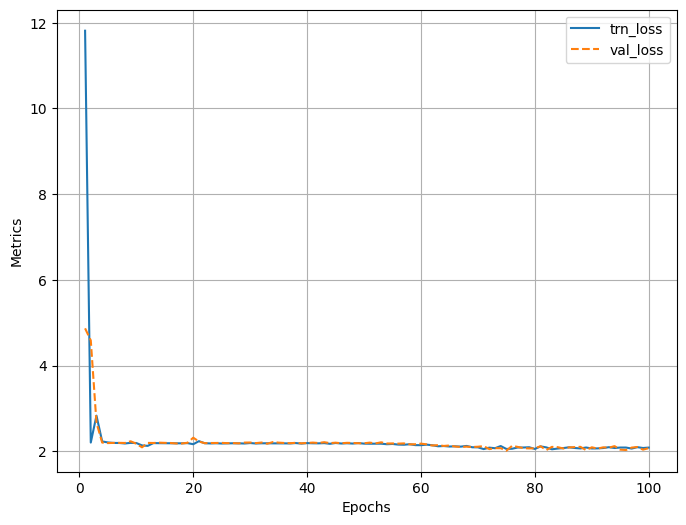

100%|██████████| 201/201 [00:00<00:00, 6359.61it/s]


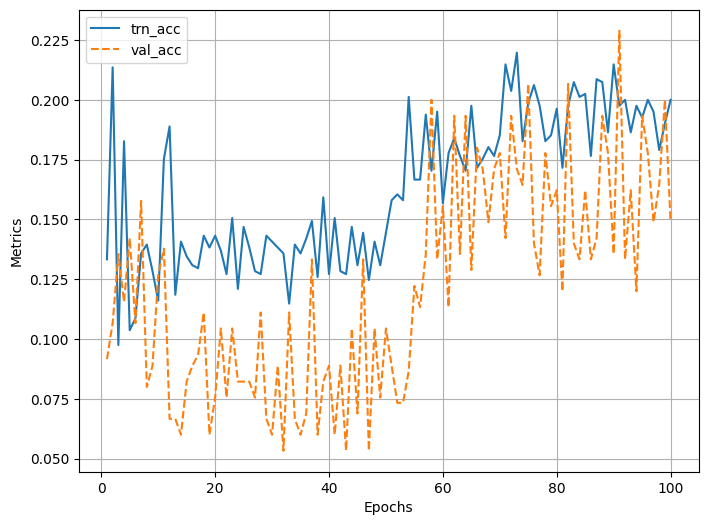

In [25]:
# results from training and validation
log.plot_epochs(['trn_loss', 'val_loss'])
log.plot_epochs(['trn_acc', 'val_acc'])

## Testing for class

In [26]:
# MELHOR TESTAR INPUTANDO SÓ UMA CLASSE
testset0 = [x for x in test_set if "000_" in x]
testload0  = GetBatches(testset0, batchsize, prep) 
testset1 = [x for x in test_set if "001_" in x]
testload1  = GetBatches(testset1, batchsize, prep) 
testset2 = [x for x in test_set if "002_" in x]
testload2  = GetBatches(testset2, batchsize, prep) 
testset3 = [x for x in test_set if "003_" in x]
testload3  = GetBatches(testset3, batchsize, prep) 
testset4 = [x for x in test_set if "004_" in x]
testload4  = GetBatches(testset4, batchsize, prep) 
testset5 = [x for x in test_set if "005_" in x]
testload5  = GetBatches(testset5, batchsize, prep) 
testset6 = [x for x in test_set if "006_" in x]
testload6  = GetBatches(testset6, batchsize, prep)
testset7 = [x for x in test_set if "007_" in x]
testload7  = GetBatches(testset7, batchsize, prep) 
testset8 = [x for x in test_set if "008_" in x]
testload8  = GetBatches(testset8, batchsize, prep) 

In [27]:

m0 = Test_per_class(model, testload0, device)
m1 = Test_per_class(model, testload1, device)
m2 = Test_per_class(model, testload2, device)
m3 = Test_per_class(model, testload3, device)
m4 = Test_per_class(model, testload4, device)
m5 = Test_per_class(model, testload5, device)
m6 = Test_per_class(model, testload6, device)
m7 = Test_per_class(model, testload7, device)
m8 = Test_per_class(model, testload8, device)


tensor([[[[0.0000, 0.0000, 0.0000,  ..., 0.8576, 0.6548, 0.5686],
          [0.0000, 0.0000, 0.0000,  ..., 0.9404, 0.6548, 0.6706],
          [0.0000, 0.0000, 0.0000,  ..., 0.9404, 0.6554, 0.7198],
          ...,
          [0.0000, 0.0000, 0.0000,  ..., 0.5649, 0.8242, 0.8242],
          [0.0000, 0.0000, 0.0000,  ..., 0.2613, 0.6754, 0.6754],
          [0.0000, 0.0000, 0.0000,  ..., 0.1918, 0.1591, 0.1948]],

         [[0.7554, 0.6675, 0.6234,  ..., 0.0219, 0.1016, 0.3099],
          [0.7554, 0.7692, 0.7692,  ..., 0.0000, 0.0360, 0.3099],
          [0.7693, 0.8308, 0.8308,  ..., 0.0000, 0.0000, 0.1617],
          ...,
          [0.7755, 0.7817, 0.7803,  ..., 0.3285, 0.0000, 0.3628],
          [0.7713, 0.8176, 0.8176,  ..., 0.3285, 0.2941, 0.4006],
          [0.7754, 0.8322, 0.8176,  ..., 0.5365, 0.5178, 0.5316]],

         [[0.8232, 0.8232, 0.9042,  ..., 0.9409, 0.9409, 0.9201],
          [0.8234, 0.8232, 0.9042,  ..., 0.8859, 0.8903, 0.9201],
          [0.8234, 0.8173, 0.8173,  ..., 0

/home/c97818a/mo434_venv/lib64/python3.8/site-packages/sklearn/metrics/_classification.py:697: RuntimeWarning: invalid value encountered in scalar divide
  k = np.sum(w_mat * confusion) / np.sum(w_mat * expected)
/home/c97818a/mo434_venv/lib64/python3.8/site-packages/sklearn/metrics/_classification.py:697: RuntimeWarning: invalid value encountered in scalar divide
  k = np.sum(w_mat * confusion) / np.sum(w_mat * expected)
/home/c97818a/mo434_venv/lib64/python3.8/site-packages/sklearn/metrics/_classification.py:697: RuntimeWarning: invalid value encountered in scalar divide
  k = np.sum(w_mat * confusion) / np.sum(w_mat * expected)
/home/c97818a/mo434_venv/lib64/python3.8/site-packages/sklearn/metrics/_classification.py:697: RuntimeWarning: invalid value encountered in scalar divide
  k = np.sum(w_mat * confusion) / np.sum(w_mat * expected)


tensor([[[[6.7880e-01, 7.5653e-01, 6.4048e-01,  ..., 2.3793e+00,
           2.5015e+00, 2.5263e+00],
          [6.7880e-01, 7.5653e-01, 6.4048e-01,  ..., 2.3793e+00,
           2.5015e+00, 2.5371e+00],
          [4.1260e-01, 5.9832e-01, 5.9832e-01,  ..., 2.1947e+00,
           2.4866e+00, 2.5371e+00],
          ...,
          [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00,
           0.0000e+00, 0.0000e+00],
          [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00,
           0.0000e+00, 0.0000e+00],
          [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00,
           0.0000e+00, 0.0000e+00]],

         [[6.6832e-02, 2.5794e-02, 2.7237e-01,  ..., 0.0000e+00,
           0.0000e+00, 0.0000e+00],
          [1.3086e-01, 7.4700e-02, 2.4674e-01,  ..., 0.0000e+00,
           0.0000e+00, 0.0000e+00],
          [3.0772e-01, 1.1508e-01, 3.1937e-01,  ..., 0.0000e+00,
           0.0000e+00, 0.0000e+00],
          ...,
          [7.7507e-01, 8.6105e-01, 8.6105e-01,  ..., 7.3373

/home/c97818a/mo434_venv/lib64/python3.8/site-packages/sklearn/metrics/_classification.py:697: RuntimeWarning: invalid value encountered in scalar divide
  k = np.sum(w_mat * confusion) / np.sum(w_mat * expected)
/home/c97818a/mo434_venv/lib64/python3.8/site-packages/sklearn/metrics/_classification.py:697: RuntimeWarning: invalid value encountered in scalar divide
  k = np.sum(w_mat * confusion) / np.sum(w_mat * expected)
/home/c97818a/mo434_venv/lib64/python3.8/site-packages/sklearn/metrics/_classification.py:697: RuntimeWarning: invalid value encountered in scalar divide
  k = np.sum(w_mat * confusion) / np.sum(w_mat * expected)
/home/c97818a/mo434_venv/lib64/python3.8/site-packages/sklearn/metrics/_classification.py:697: RuntimeWarning: invalid value encountered in scalar divide
  k = np.sum(w_mat * confusion) / np.sum(w_mat * expected)
/home/c97818a/mo434_venv/lib64/python3.8/site-packages/sklearn/metrics/_classification.py:697: RuntimeWarning: invalid value encountered in scalar d

tensor([[[[0.0000, 0.2336, 0.6294,  ..., 2.2611, 2.3467, 2.3467],
          [0.0000, 0.2336, 0.6294,  ..., 2.6594, 3.1813, 2.9084],
          [0.0000, 0.0000, 0.3227,  ..., 2.7305, 3.1813, 3.0483],
          ...,
          [0.0000, 0.0000, 0.0000,  ..., 0.9384, 1.2135, 1.2140],
          [0.0000, 0.0000, 0.0000,  ..., 1.2919, 1.4225, 1.4507],
          [0.0000, 0.0000, 0.0000,  ..., 2.2833, 2.3034, 2.3034]],

         [[0.8039, 0.5926, 0.0986,  ..., 0.0000, 0.0000, 0.0000],
          [0.8039, 0.6147, 0.4086,  ..., 0.0000, 0.0000, 0.0000],
          [0.7749, 0.6939, 0.6525,  ..., 0.0000, 0.0000, 0.0000],
          ...,
          [0.5406, 0.4908, 0.4638,  ..., 0.0000, 0.0000, 0.0000],
          [0.4825, 0.4350, 0.3879,  ..., 0.0000, 0.0000, 0.0000],
          [0.5120, 0.4660, 0.3947,  ..., 0.0000, 0.0000, 0.0000]],

         [[0.8302, 0.7514, 0.8623,  ..., 0.3408, 0.6069, 0.9716],
          [0.8498, 0.7514, 0.7835,  ..., 0.0000, 0.0000, 0.6154],
          [0.8208, 0.7530, 0.7520,  ..., 0

In [28]:

df_metrics = pd.DataFrame(columns=['Mean kappa', 'Std kappa', 'Mean accuracy', 'Std accuracy'])
df_metrics.loc[len(df_metrics)] = m0
df_metrics.loc[len(df_metrics)] = m1
df_metrics.loc[len(df_metrics)] = m2
df_metrics.loc[len(df_metrics)] = m3
df_metrics.loc[len(df_metrics)] = m4
df_metrics.loc[len(df_metrics)] = m5
df_metrics.loc[len(df_metrics)] = m6
df_metrics.loc[len(df_metrics)] = m7
df_metrics.loc[len(df_metrics)] = m8


In [29]:
fish_numbers = {
              0:'Black Sea Sprat',
              1:'Gilt-Head Bream', 
              2:'Hourse Mackerel',
              3:'Red Mullet',
              4:'Red Sea Bream', 
              5:'Sea Bass',
              6:'Shrimp',
              7:'Striped Red Mullet',
              8:'Trout'
              }
df_metrics['Fish class']=[fish_numbers[i] for i in range(len(df_metrics))]
df_metrics

,Mean kappa,Std kappa,Mean accuracy,Std accuracy,Fish class
0,0.8,0.4,0.8,0.4,Black Sea Sprat
1,0.0,0.0,0.0,0.0,Gilt-Head Bream
2,0.0,0.0,0.0,0.0,Hourse Mackerel
3,0.0,0.0,0.0,0.0,Red Mullet
4,0.0,0.0,0.0,0.0,Red Sea Bream
5,0.0,0.0,0.0,0.0,Sea Bass
6,0.9,0.3,0.9,0.3,Shrimp
7,0.0,0.0,0.0,0.0,Striped Red Mullet
8,0.0,0.0,0.0,0.0,Trout


In [30]:
# Save model
torch.save(model.state_dict(), 'cnn_dict_B.pth')
torch.save(model, 'cnn_model_B.pth')

# Grad-CAM: Gradient weighted Class Activation Mapping

In [31]:
import matplotlib.cm as cm
import cv2

In [44]:
def get_activations(model, x, device):
    # I'm redoing forward so I can acess the output
    # move input tensor x to the selected device
    x = x.to(device)
    # get activations after feature extraction
    x1 = model.conv1(x)
    x2 = model.conv2(x1)
    x1 = torch.nn.functional.interpolate(x1, 
                                        scale_factor=(0.5,0.5),
                                        mode='nearest',
                                        recompute_scale_factor=True)
    x = torch.cat((x1, x2), dim=1)
    x3 = model.conv3(x)
    x4 = model.conv4(x3)

    x3 = torch.nn.functional.interpolate(x3, 
                                        scale_factor=(0.5,0.5),
                                        mode='nearest',
                                        recompute_scale_factor=True)
    x = torch.cat((x3, x4), dim=1)
    x5 = model.conv5(x)
    return x5

def get_output_of_the_model(model, x, device):
    # put the model in the evaluation mode
    model.eval()
    # move input tensor x to the selected device
    x =x.to(device)
    # execute the model with gradients
    output = model(x)
    return output

def get_heatmap(model, x, device, model_name, label_maps):
    # add one dimension (dim=0 must be the number of images)
    xin = x.unsqueeze(0)
    #get the  output of the feature extractor
    activ = get_activations(model, xin, device)

    # get the predictionsat the output of the decision layer
    logits = get_output_of_the_model(model, xin, device)

    # get the most confident prediction
    pred = logits.max(-1)[-1]
    print("predicted label:", pred.cpu().detach().numpy()[0])

    # compute gradients with respect to the most confident prediction
    model.zero_grad()
    logits[0, pred].backward(retain_graph=True)

    print(activ.shape)
    # only conv2d generates gradients in the feature extractor: extracts them
    for layer_name, layer in model.conv1.named_children():
        if layer_name == '0':
            grad1 = layer.weight.grad
            nchannels1 = grad1.shape[0]
            # compute the weighted mean of the activations across channels 
            # using the mean value of the gradient of each filter parameter as weight
            for i in range(16):
                activ[:, i, :, :] *= grad1[i].mean()
    
    for layer_name, layer in model.conv2.named_children():
        if layer_name=='0':
            grad2 = layer.weight.grad
            nchannels2 = grad2.shape[0]
            for i in range(64):
                activ[:, i+16, :, :] *= grad2[i].mean()
    
    heatmap = torch.mean(activ, dim=1)[0].cpu().detach()

    # convert to numpy, normalize, and resize to the input size
    heatmap = heatmap.squeeze(0).numpy()
    heatmap = (heatmap - heatmap.min())/(heatmap.max()-heatmap.min())
    heatmap = cv2.resize(heatmap, (x.shape[2], x.shape[1]))
    return heatmap

def display_image_with_heatmap(img, heatmap, scale):
    heatmap = np.uint8(255 * heatmap)
    width = int(heatmap.shape[1]*scale)
    height = int (heatmap.shape[0]*scale)
    heatmap = cv2.resize(heatmap, (width, height))
    img = cv2.resize(img,(width, height))
    heatmap = cv2.applyColorMap(255-heatmap, cv2.COLORMAP_JET)
    heatmap = np.uint8(heatmap)
    heatmap = np.uint8(heatmap*0.7 + img*0.3)
    plt.imshow(heatmap)
    plt.show()


In [36]:
target_from_tensor = str(valid_set[0]).split("/")[-1].split("_")[0]

from PIL import Image

img_cam = Image.open(valid_set[0])
img_cam = prep(img_cam)

True label:  003
Entra com tamanho  torch.Size([3, 512, 384])
Pos unsqueeze  torch.Size([1, 3, 512, 384])
tensor([[[[0.0000, 0.1193, 0.2558,  ..., 1.5664, 1.5664, 1.2875],
          [0.0000, 0.2506, 0.5186,  ..., 1.8843, 2.1640, 1.9963],
          [0.0000, 0.2996, 0.7466,  ..., 2.1453, 2.1640, 1.9963],
          ...,
          [0.0000, 0.0000, 0.0000,  ..., 2.7687, 3.0492, 3.0492],
          [0.0000, 0.0000, 0.0000,  ..., 0.1664, 0.1664, 0.1198],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],

         [[0.6995, 0.4904, 0.2690,  ..., 0.0000, 0.0000, 0.1446],
          [0.6995, 0.4904, 0.2690,  ..., 0.0000, 0.0000, 0.0070],
          [0.6720, 0.4032, 0.2869,  ..., 0.0000, 0.0000, 0.0000],
          ...,
          [0.8125, 0.7509, 0.8367,  ..., 0.0000, 0.0000, 0.4981],
          [0.7734, 0.7509, 0.8367,  ..., 0.7107, 0.7919, 0.7919],
          [0.4857, 0.6840, 0.7025,  ..., 0.7107, 0.7919, 0.8685]],

         [[0.7752, 0.7853, 0.8923,  ..., 0.7837, 0.9126, 0.9762],
  

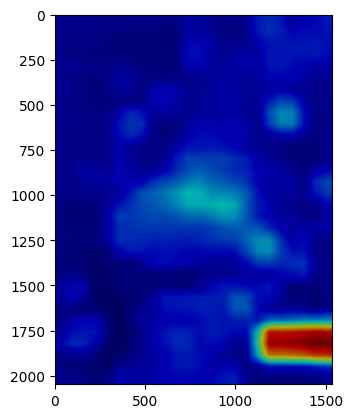

In [37]:
# Example of single image
x = img_cam
x = x.float()
true_label = target_from_tensor
print("True label: ", true_label)
heatmap = get_heatmap(model, x, device, model_name='Fish Classifier', label_maps = fish_types)
x = x.permute(1,2,0).numpy()
if x.shape[2]==1: #convert it to three channels
    x =  x.squeeze(2)
    x = np.stack((x,)*3, axis=-1)
display_image_with_heatmap(x, heatmap, 4)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


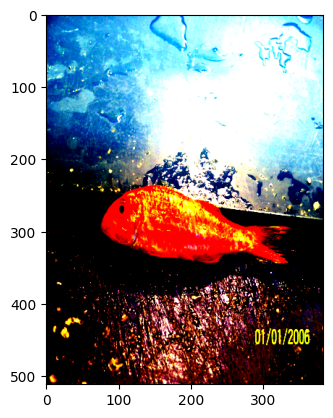

In [38]:
plt.imshow(img_cam.permute(1, 2, 0))

True label:  000
tensor([[[[0.0000, 0.0000, 0.0000,  ..., 2.1457, 1.7690, 1.6390],
          [0.0000, 0.0000, 0.0000,  ..., 2.3712, 1.9378, 1.7206],
          [0.0000, 0.0000, 0.0000,  ..., 2.3712, 1.8796, 1.9311],
          ...,
          [0.0000, 0.0000, 0.0000,  ..., 0.1802, 0.4059, 0.6822],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.2194, 0.6822],
          [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],

         [[0.7662, 0.7051, 0.7457,  ..., 0.0000, 0.0000, 0.0000],
          [0.7708, 0.7210, 0.7457,  ..., 0.0000, 0.0000, 0.0000],
          [0.8243, 0.7343, 0.7353,  ..., 0.0000, 0.0000, 0.0000],
          ...,
          [0.7772, 0.8241, 0.8191,  ..., 0.6654, 0.4920, 0.1720],
          [0.7754, 0.8169, 0.8221,  ..., 0.7917, 0.7530, 0.4779],
          [0.7636, 0.7847, 0.8024,  ..., 0.8519, 0.8194, 0.8605]],

         [[0.8282, 0.8179, 0.8687,  ..., 0.7395, 0.7395, 0.8837],
          [0.7832, 0.8190, 0.8190,  ..., 0.3785, 0.3785, 0.5187],
          [0.8483, 0.7948

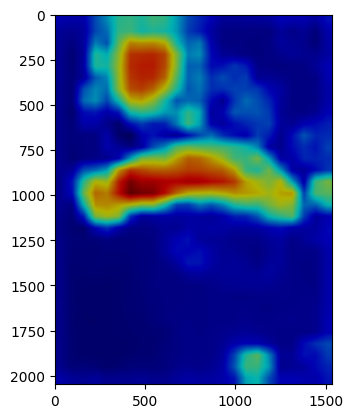

In [46]:
# Example for each class:

def display_image_with_heatmap_batch(heatmap, scale):
    heatmap = np.uint8(255 * heatmap)
    width = int(heatmap.shape[1]*scale)
    height = int (heatmap.shape[0]*scale)
    heatmap = cv2.resize(heatmap, (width, height))
    heatmap = cv2.applyColorMap(255-heatmap, cv2.COLORMAP_JET)
    heatmap = np.uint8(heatmap)
    heatmap = np.uint8(heatmap*0.7 )
    plt.imshow(heatmap)
    plt.show()

# Doing a loop for some classes (0,3,6)
heatmap_sum = np.zeros((512,384))
for test_img in testset0:
    img_cam = Image.open(test_img)
    img_cam = prep(img_cam)
    x = img_cam
    x = x.float()
    target_from_tensor = str(test_img).split("/")[-1].split("_")[0]
    true_label = target_from_tensor
    print("True label: ", true_label)
    heatmap = get_heatmap(model, x, device, model_name='Fish Classifier', label_maps = fish_types)
    heatmap_sum = np.add(heatmap, heatmap_sum)

display_image_with_heatmap_batch(heatmap, 4)

True label:  003
tensor([[[[0.0000, 0.0000, 0.0000,  ..., 1.3104, 1.3996, 1.5478],
          [0.0000, 0.0000, 0.1369,  ..., 1.3969, 1.3996, 1.5478],
          [0.0000, 0.0000, 0.5303,  ..., 1.3969, 1.3969, 1.4091],
          ...,
          [0.0000, 0.0000, 0.2066,  ..., 0.8548, 1.1630, 1.1630],
          [0.0000, 0.0000, 0.0771,  ..., 1.2425, 1.9594, 1.9594],
          [0.0000, 0.0000, 0.0000,  ..., 1.3599, 1.9594, 1.9594]],

         [[0.6188, 0.6116, 0.6116,  ..., 0.0000, 0.0000, 0.0000],
          [0.7271, 0.6720, 0.6116,  ..., 0.0000, 0.0000, 0.0000],
          [0.7271, 0.6720, 0.2684,  ..., 0.0000, 0.0000, 0.0000],
          ...,
          [0.7038, 0.7002, 0.5228,  ..., 0.0092, 0.0000, 0.2131],
          [0.7038, 0.7214, 0.6985,  ..., 0.0092, 0.0000, 0.1583],
          [0.7677, 0.7983, 0.8002,  ..., 0.1448, 0.0000, 0.3069]],

         [[0.8689, 0.8689, 0.8609,  ..., 0.7391, 0.7114, 0.8795],
          [0.8689, 0.8689, 0.8609,  ..., 0.4973, 0.4750, 0.5545],
          [0.8277, 0.8277

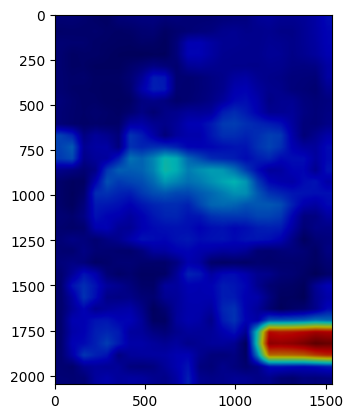

In [47]:
# Doing a loop for some classes (0,3,6)
heatmap_sum = np.zeros((512,384))
for test_img in testset3:
    img_cam = Image.open(test_img)
    img_cam = prep(img_cam)
    x = img_cam
    x = x.float()
    target_from_tensor = str(test_img).split("/")[-1].split("_")[0]
    true_label = target_from_tensor
    print("True label: ", true_label)
    heatmap = get_heatmap(model, x, device, model_name='Fish Classifier', label_maps = fish_types)
    heatmap_sum = np.add(heatmap, heatmap_sum)

display_image_with_heatmap_batch(heatmap, 4)

True label:  006
tensor([[[[0.1818, 0.4876, 0.6345,  ..., 0.0000, 0.0000, 0.0000],
          [0.2592, 0.4876, 0.6345,  ..., 0.0000, 0.0000, 0.0000],
          [0.4636, 0.5895, 0.5378,  ..., 0.0000, 0.0000, 0.0000],
          ...,
          [0.0000, 0.2859, 0.5717,  ..., 2.8460, 3.0200, 3.0200],
          [0.0000, 0.0000, 0.1396,  ..., 0.7517, 0.7304, 0.6613],
          [0.0000, 0.0000, 0.0000,  ..., 0.1520, 0.0504, 0.0504]],

         [[0.4519, 0.1976, 0.0737,  ..., 0.8714, 0.8762, 0.8781],
          [0.4519, 0.1976, 0.2097,  ..., 0.8714, 0.8762, 0.8781],
          [0.3941, 0.1188, 0.2115,  ..., 0.8237, 0.8233, 0.8411],
          ...,
          [0.4777, 0.3399, 0.0969,  ..., 0.0000, 0.0000, 0.4157],
          [0.5919, 0.4505, 0.5116,  ..., 0.3562, 0.3562, 0.4700],
          [0.6548, 0.4983, 0.5764,  ..., 0.6074, 0.6079, 0.6276]],

         [[0.8111, 0.8111, 0.7752,  ..., 0.7403, 0.7403, 0.7320],
          [0.7434, 0.7555, 0.7555,  ..., 0.7403, 0.7403, 0.7375],
          [0.7185, 0.7555

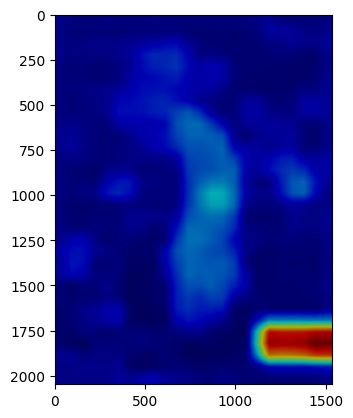

In [48]:
# Doing a loop for some classes (0,3,6)
heatmap_sum = np.zeros((512,384))
for test_img in testset6:
    img_cam = Image.open(test_img)
    img_cam = prep(img_cam)
    x = img_cam
    x = x.float()
    target_from_tensor = str(test_img).split("/")[-1].split("_")[0]
    true_label = target_from_tensor
    print("True label: ", true_label)
    heatmap = get_heatmap(model, x, device, model_name='Fish Classifier', label_maps = fish_types)
    heatmap_sum = np.add(heatmap, heatmap_sum)

display_image_with_heatmap_batch(heatmap, 4)

# Projection from last hidden layer

In [ ]:
from collections import OrderedDict

In [ ]:
# get the output of each layer/block
def get_each_output(model, x):
    output_by_layer = OrderedDict()

    # get the input
    output_by_layer['input'] = x.clone().detach().cpu().data.numpy()

    #for the first block, gets it output and save it
    x1 = model.conv1(x)
    output_by_layer['feat_extract_conv1'] = x1.clone().detach().cpu().numpy()

    #for the second block, gets it output and save it
    x2 = model.conv2(x1)
    output_by_layer['feat_extract_conv2'] = x2.clone().detach().cpu().numpy()

    #resizes and concatenate x1 and x2, saving the output
    x1 = torch.nn.functional.interpolate(x1, 
                                        scale_factor=(0.5,0.5),
                                        mode='nearest',
                                        recompute_scale_factor=True)
    x = torch.cat((x1, x2), dim=1)
    output_by_layer['feat_extract_concat1'] = x.clone().detach().cpu().numpy()

    #for the third block, gets it output and save it
    x3 = model.conv3(x)
    output_by_layer['feat_extract_conv3'] = x3.clone().detach().cpu().numpy()

    #for the fourth block, gets it output and save it
    x4 = model.conv4(x3)
    output_by_layer['feat_extract_conv4'] = x4.clone().detach().cpu().numpy()

    #resizes and concatenate x3 and x4, saving the output   
    x3 = torch.nn.functional.interpolate(x3, 
                                        scale_factor=(0.5,0.5),
                                        mode='nearest',
                                        recompute_scale_factor=True)
    x = torch.cat((x3, x4), dim=1)
    output_by_layer['feat_extract_concat2'] = x.clone().detach().cpu().numpy()
    x5 = model.conv5(x)

    # trnasform features to a 2D tensor: you do not need to show this one
    x = torch.flatten(x5, start_dim=1)

    # for each layer of the classifier (note that you could have done that for model.conv1 and model.conv2 as well)
    for layer_name, layer in model.classifier.named_children():
        # do forwars through the layer
        x = layer.forward(x)
        # save the output
        output_by_layer["classifier-"+layer_name] = x.clone().detach().cpu().numpy()

    return output_by_layer


def get_outputs(model, dataload, device):
    outputs_by_layer = None
    all_labels = None

    # get a batch from the dataload
    for inputs, labels in dataload:
        # move inputs to the correct device
        inputs = inputs.to(device)
        labels = labels.clone().detach().cpu().numpy()

        # get the activations for visualization
        outputs = get_each_output(model, inputs)

        # save outputs
        if outputs_by_layer is None:
            outputs_by_layer = outputs
            all_labels = labels
        else:
            for layer in outputs:
                outputs_by_layer[layer] = np.concatenate((outputs_by_layer[layer], outputs[layer]), axis=0)
            all_labels = np.concatenate((all_labels, labels))

    return outputs_by_layer, all_labels

# maps from high dimension to 2D
def projection(outputs_by_layer, reducer):
    
    projection_by_layer = OrderedDict()

    for layer in outputs_by_layer:
        # get the output of layer
        output = outputs_by_layer[layer]
        output = output.reshape(output.shape[0], -1)
        print("ANTES DO FIT TRANSFORM, shape output ", output.shape)
        # map to 2D
        embedded = reducer.fit_transform(output)
        # save projection
        projection_by_layer[layer] = embedded
    
    return projection_by_layer

In [ ]:
from sklearn.manifold import TSNE

# for visualization

def create_visualization(projection_by_layer, all_labels):
    for layer in projection_by_layer:
        embedded = projection_by_layer[layer]

        fig = plt.figure(figsize=(8,8))
        plt.scatter(embedded[:,0], embedded[:,1], c=all_labels, cmap=plt.get_cmap('tab10'))
        plt.axis('off')
        plt.title(layer)
        plt.colorbar()
        plt.show()
        plt.close(fig)

In [ ]:
reducer = TSNE(perplexity = 10)

outputs_by_layer, all_labels = get_outputs(model, validload, device)
projection_by_layer = projection(outputs_by_layer, reducer)

ANTES DO FIT TRANSFORM, shape output  (129, 150528)


OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detec

ANTES DO FIT TRANSFORM, shape output  (129, 802816)


OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detec

ANTES DO FIT TRANSFORM, shape output  (129, 802816)


OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detec

ANTES DO FIT TRANSFORM, shape output  (129, 1003520)


OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detec

ANTES DO FIT TRANSFORM, shape output  (129, 401408)


OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detec

ANTES DO FIT TRANSFORM, shape output  (129, 200704)


OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detec

ANTES DO FIT TRANSFORM, shape output  (129, 301056)


OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detect OpenMP Loop and this application may hang. Please rebuild the library with USE_OPENMP=1 option.
OpenBLAS Warning : Detec

ANTES DO FIT TRANSFORM, shape output  (129, 512)
ANTES DO FIT TRANSFORM, shape output  (129, 512)
ANTES DO FIT TRANSFORM, shape output  (129, 512)
ANTES DO FIT TRANSFORM, shape output  (129, 9)


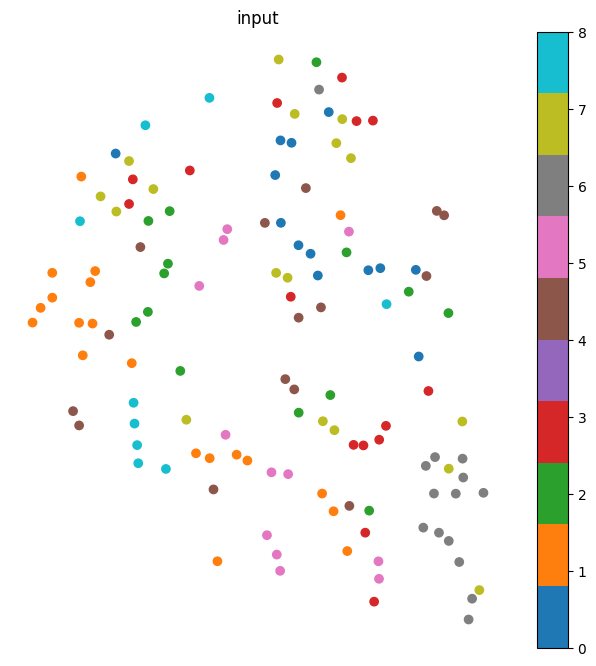

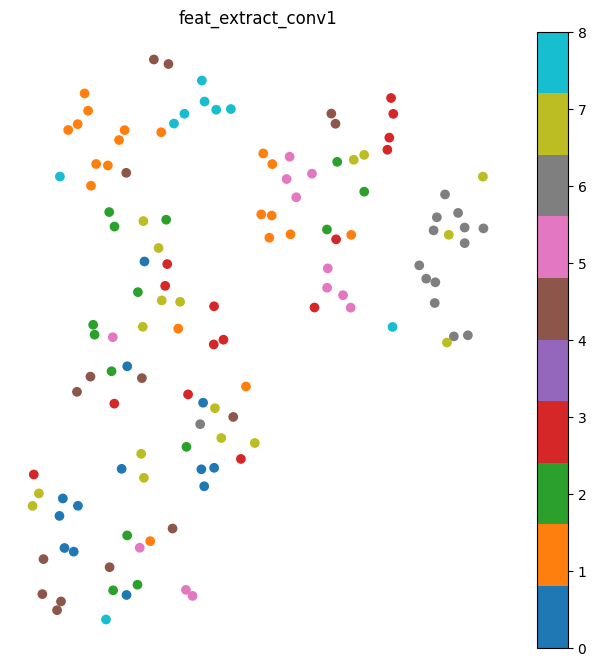

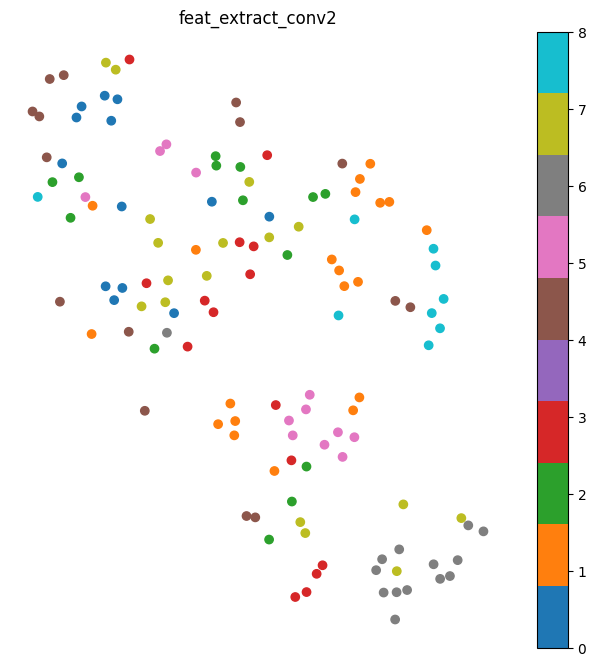

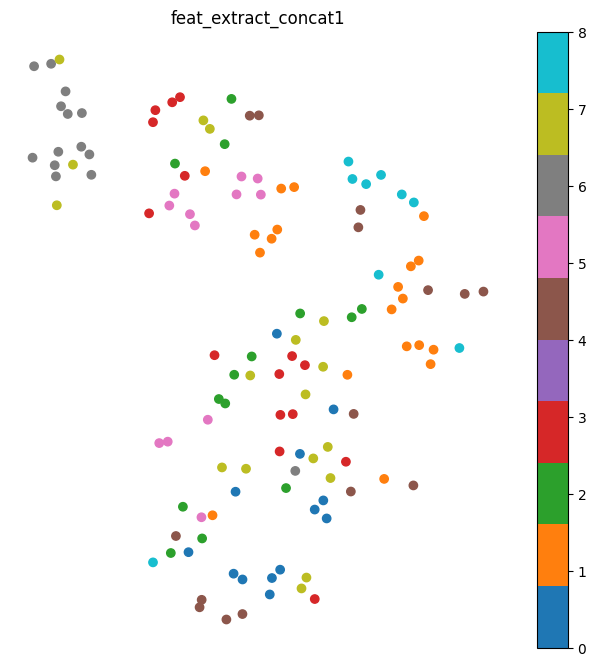

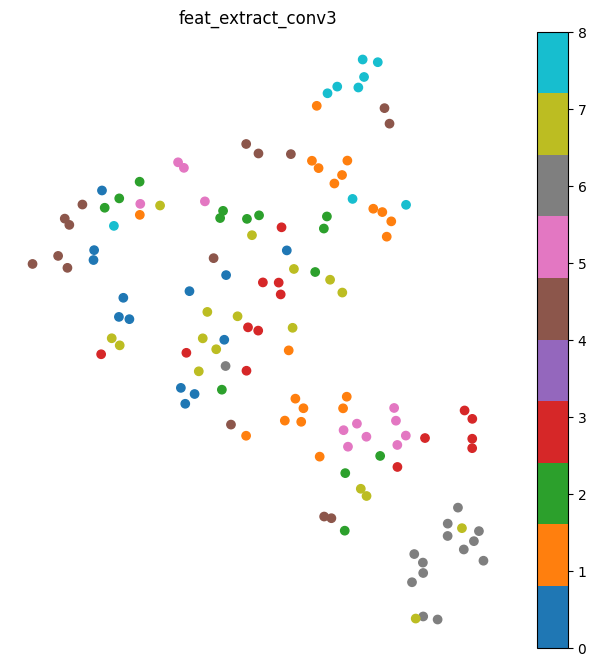

...

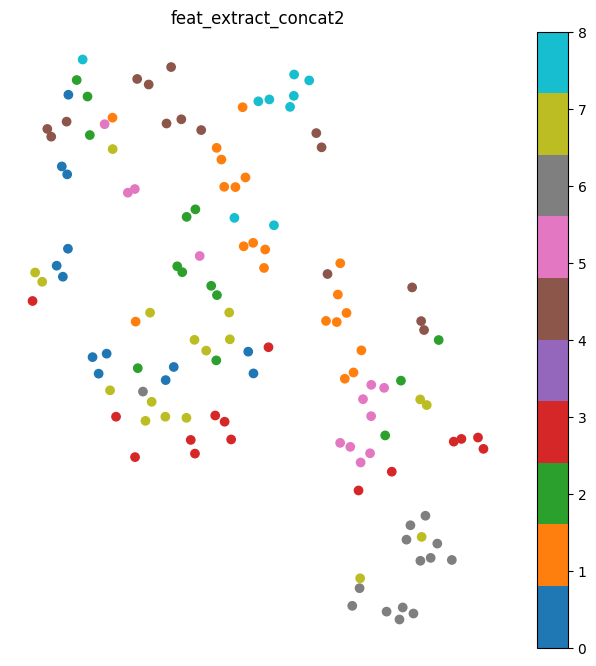

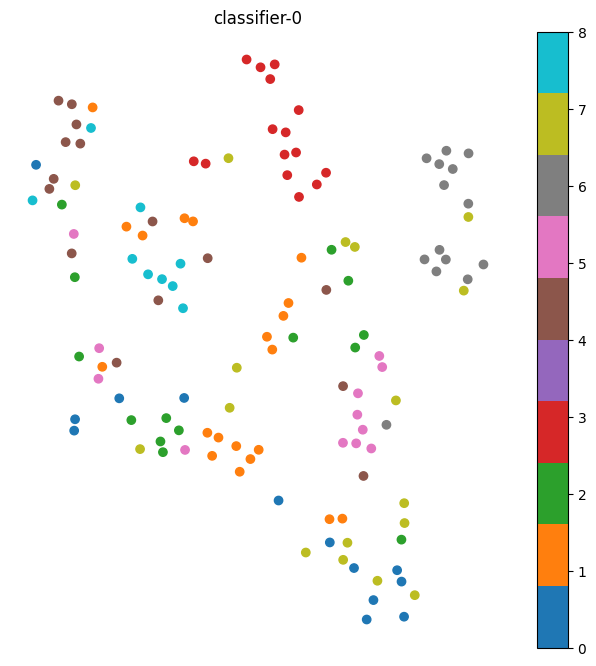

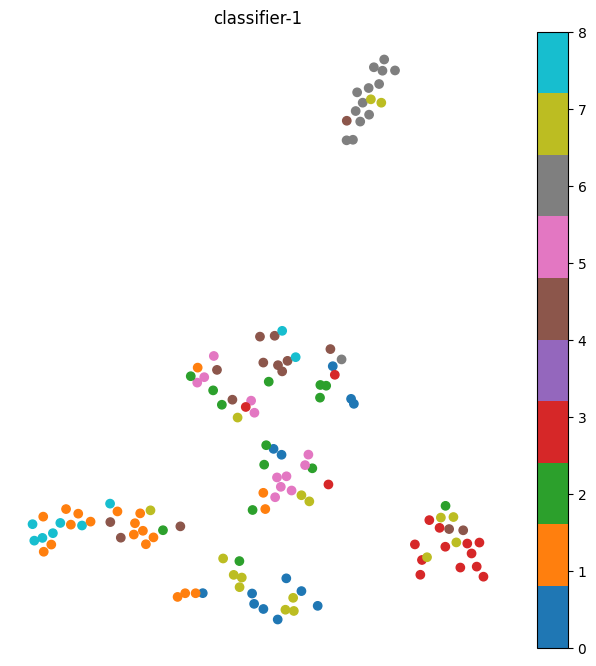

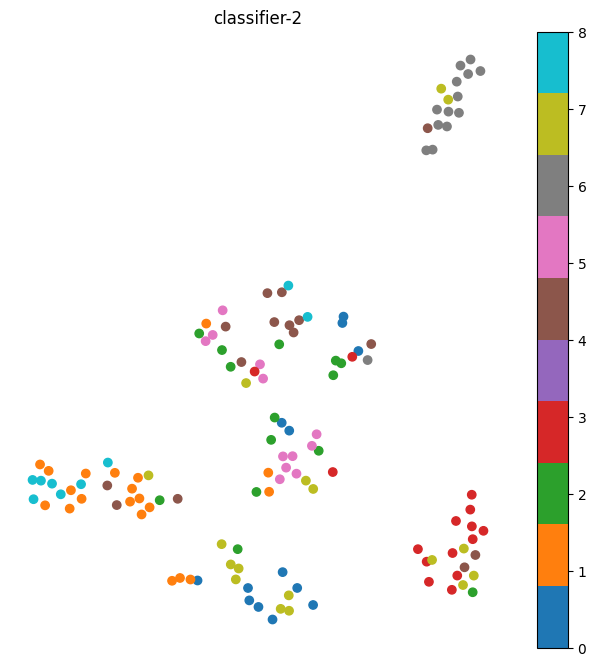

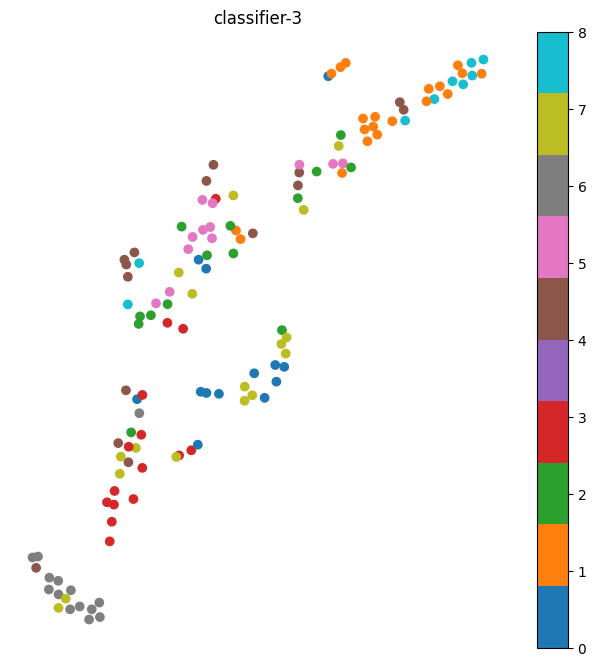

In [ ]:
create_visualization(projection_by_layer, all_labels)